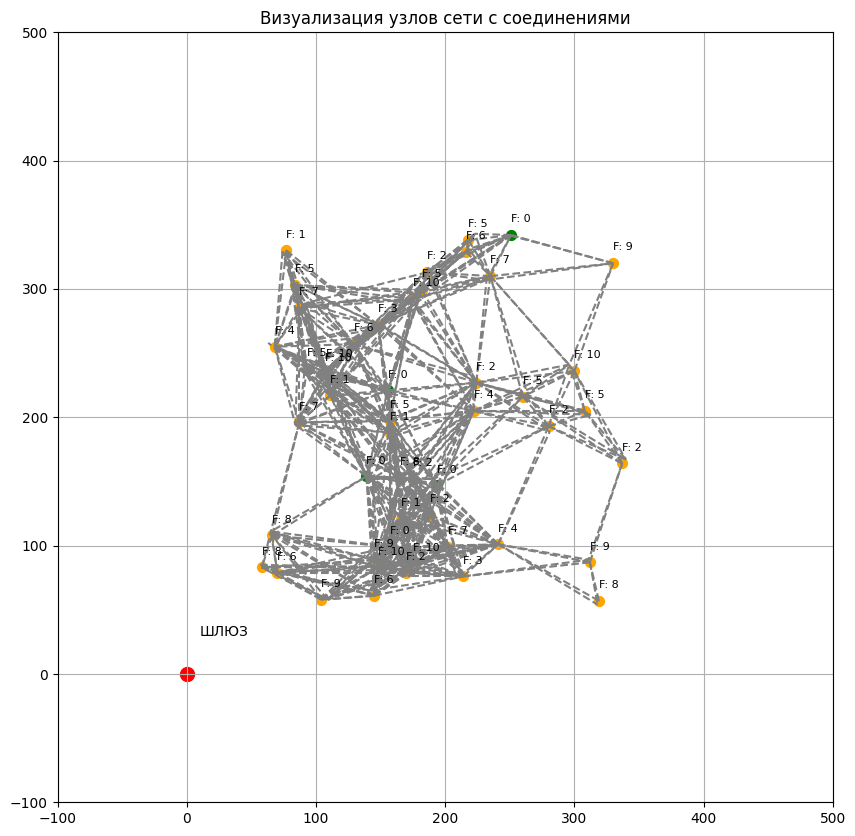

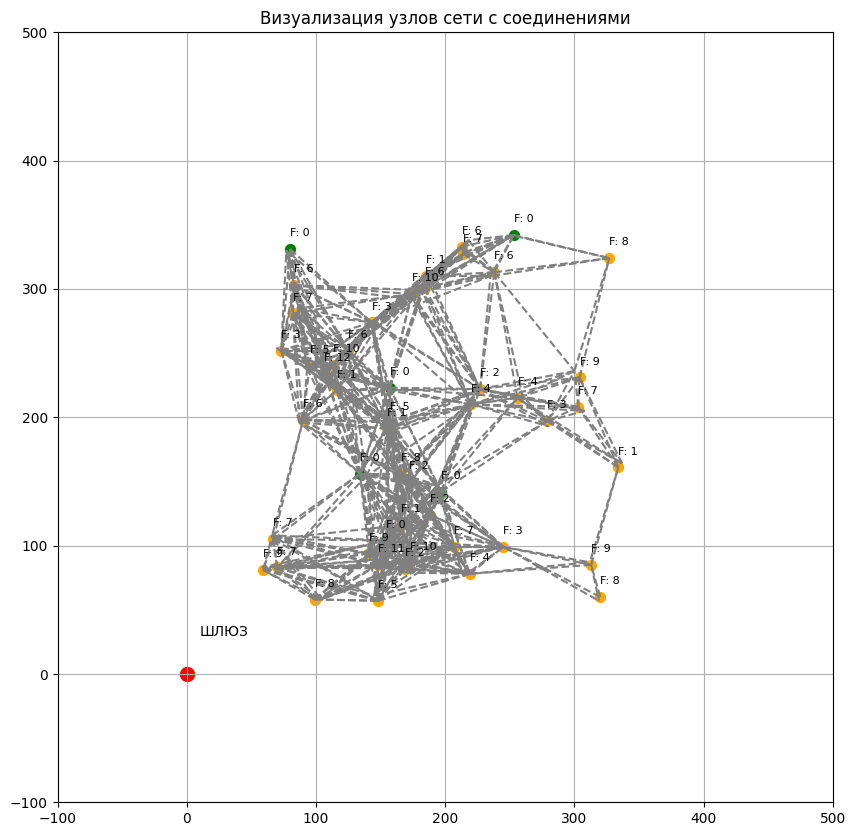

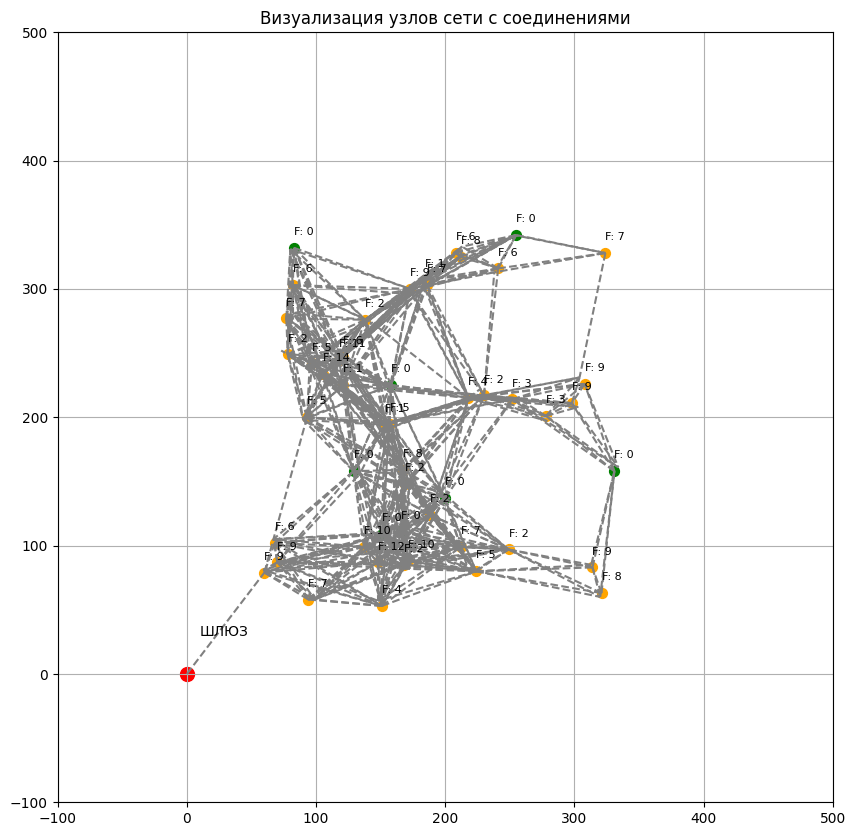

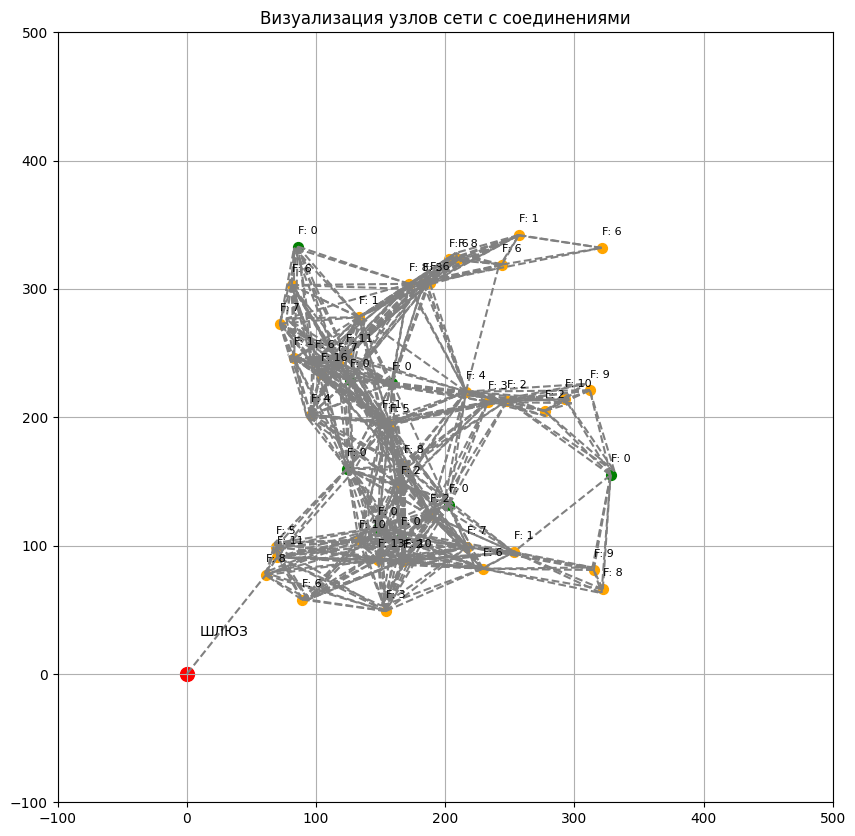

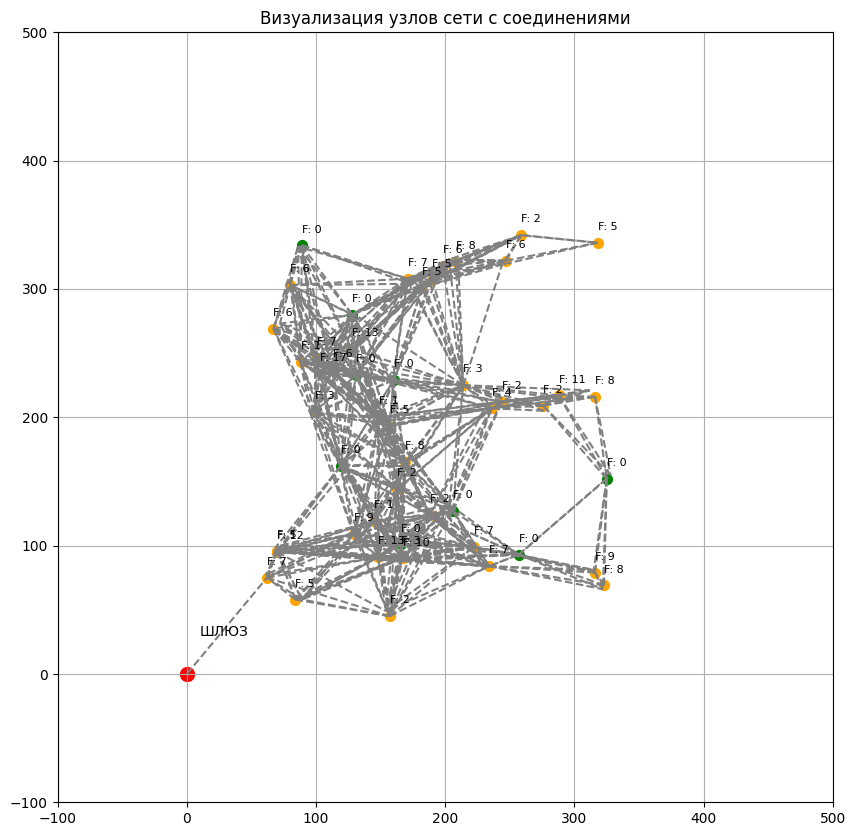

...

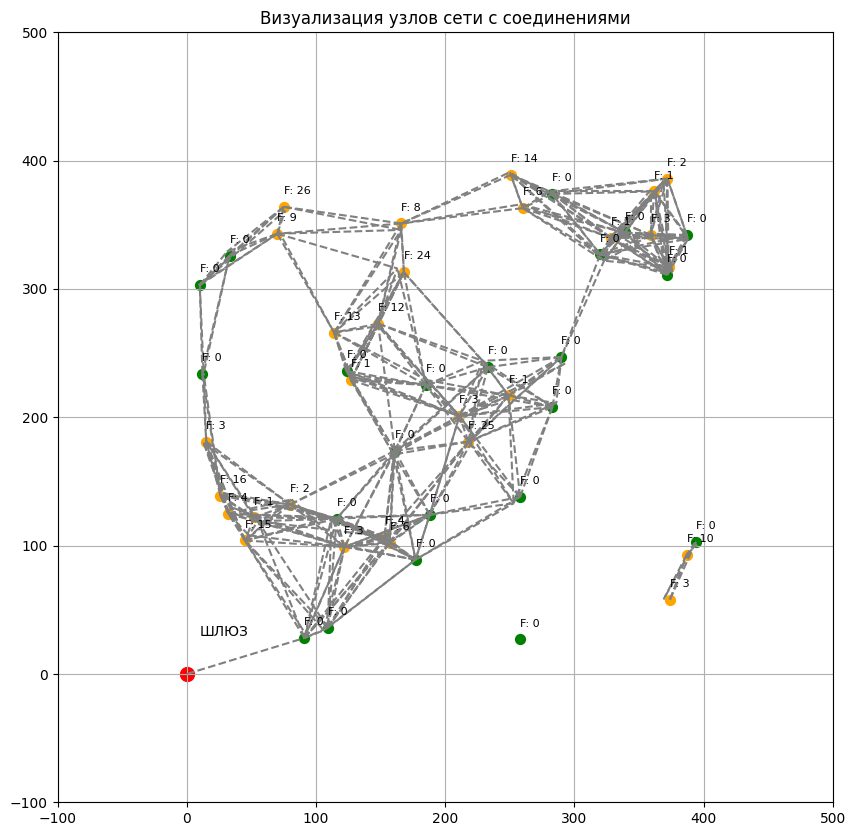

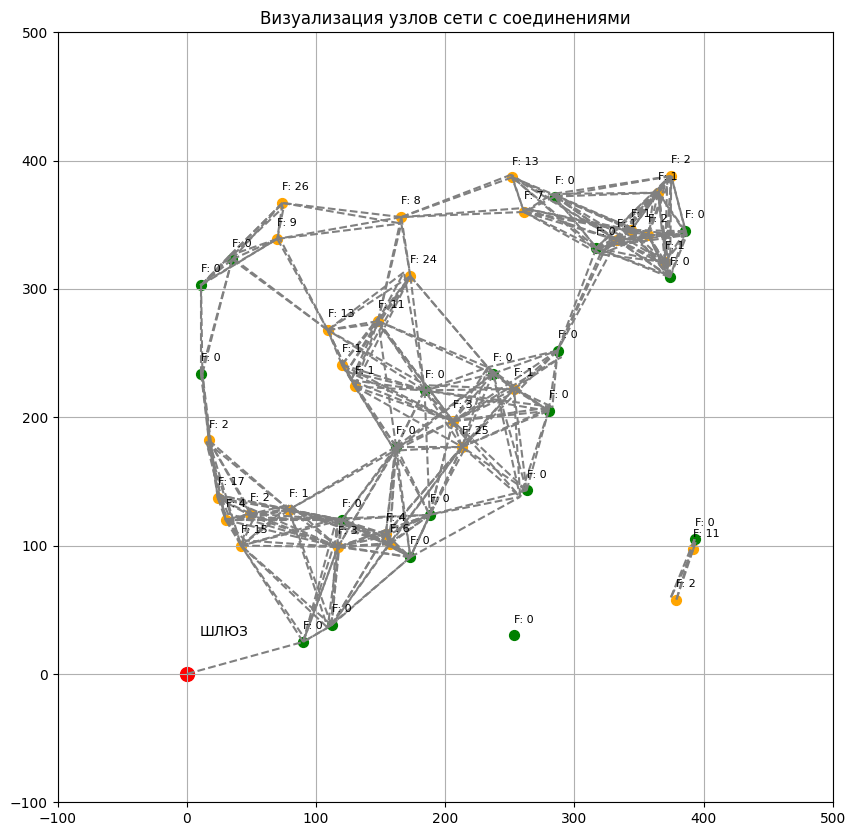

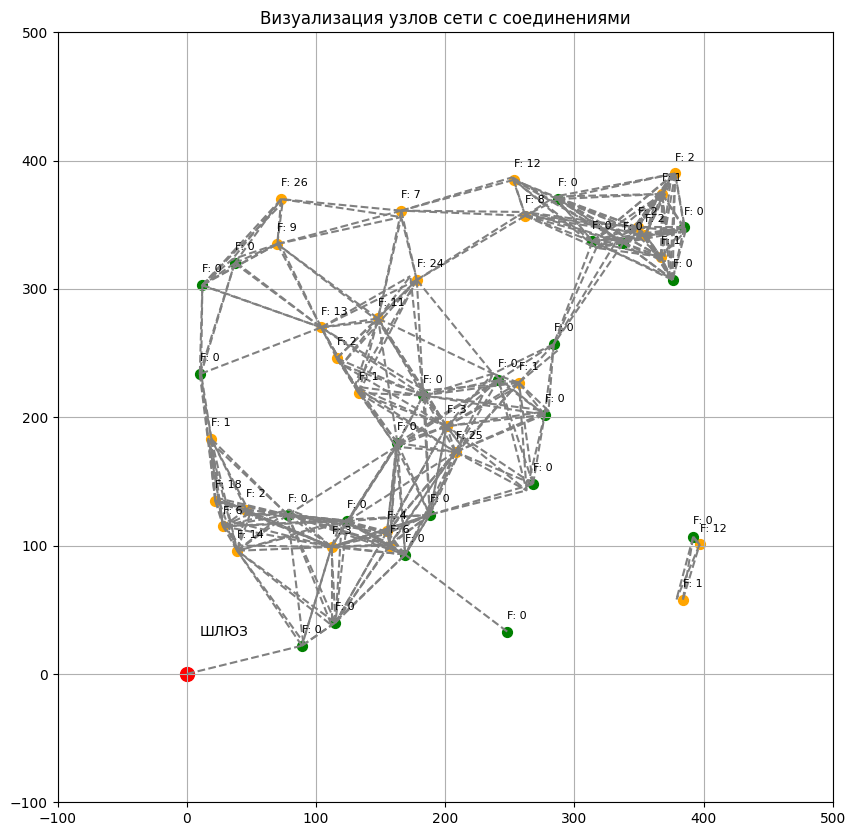

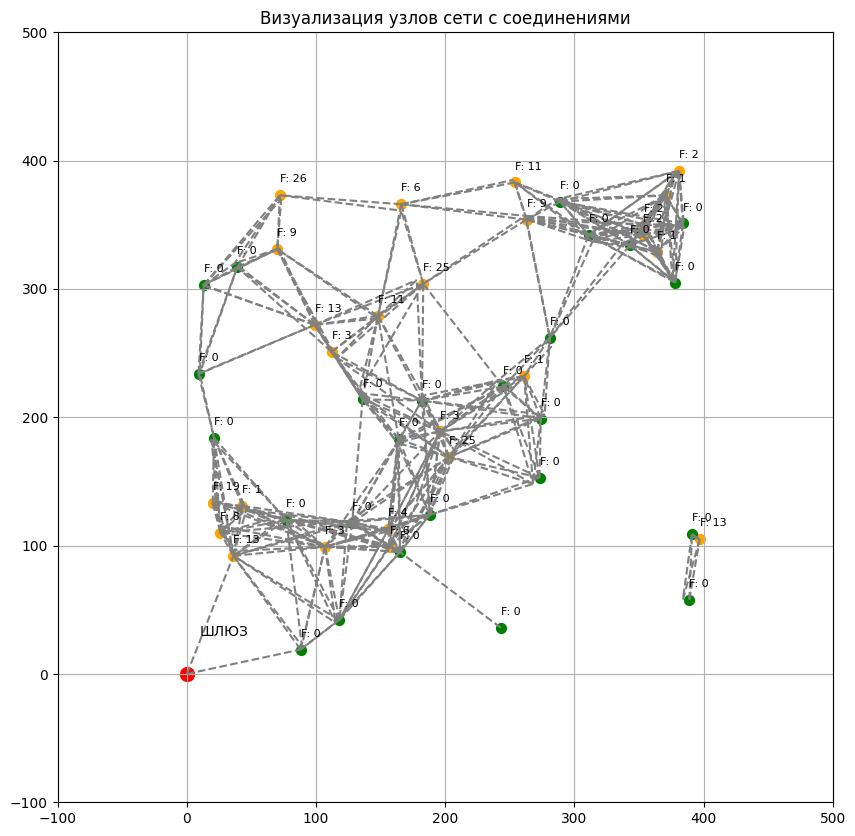

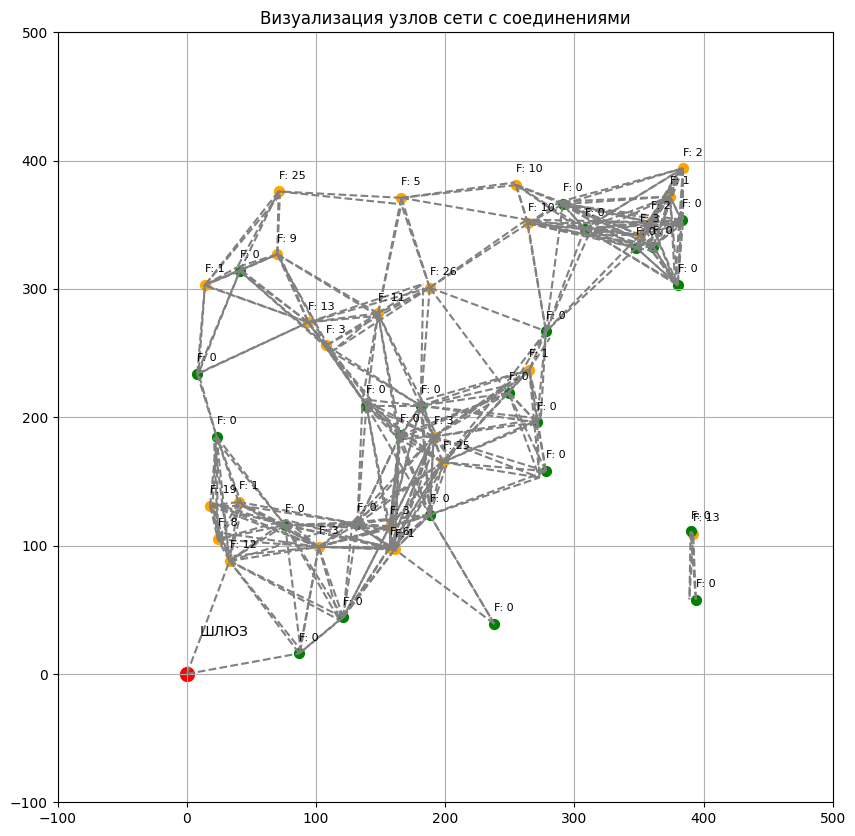


Общее количество кадров, переданных в шлюз: 35
Текущее состояние узлов (количество кадров):
Узел 1: 1 кадров
Узел 2: 3 кадров
Узел 3: 3 кадров
Узел 4: 0 кадров
Узел 5: 8 кадров
Узел 6: 13 кадров
Узел 7: 1 кадров
Узел 8: 9 кадров
Узел 9: 1 кадров
Узел 10: 0 кадров
Узел 11: 12 кадров
Узел 12: 0 кадров
Узел 13: 11 кадров
Узел 14: 0 кадров
Узел 15: 25 кадров
Узел 16: 26 кадров
Узел 17: 3 кадров
Узел 18: 0 кадров
Узел 19: 25 кадров
Узел 20: 0 кадров
Узел 21: 0 кадров
Узел 22: 13 кадров
Узел 23: 0 кадров
Узел 24: 0 кадров
Узел 25: 0 кадров
Узел 26: 1 кадров
Узел 27: 0 кадров
Узел 28: 5 кадров
Узел 29: 0 кадров
Узел 30: 0 кадров
Узел 31: 0 кадров
Узел 32: 3 кадров
Узел 33: 2 кадров
Узел 34: 19 кадров
Узел 35: 10 кадров
Узел 36: 10 кадров
Узел 37: 0 кадров
Узел 38: 0 кадров
Узел 39: 0 кадров
Узел 40: 2 кадров
Узел 41: 0 кадров
Узел 42: 6 кадров
Узел 43: 3 кадров
Узел 44: 0 кадров
Узел 45: 1 кадров
Узел 46: 0 кадров
Узел 47: 0 кадров
Узел 48: 0 кадров
Узел 49: 0 кадров
Узел 50: 0 кадров


In [24]:
import numpy as np
import matplotlib.pyplot as plt
import random

class Node:
    def __init__(self, x, y, radius):
        self.x = x  # Координата x узла
        self.y = y  # Координата y узла
        self.radius = radius  # Радиус действия узла
        self.frames = random.randint(0, 10)  # Случайное количество кадров от 0 до 10
        self.rX = random.randint(-5, 5)  # Случайное смещение по x
        self.rY = random.randint(-5, 5)  # Случайное смещение по y

    def move(self):
        # Изменение координат узла
        if 0 <= self.x + self.rX <= 400:
            self.x += self.rX  # Изменение координаты x
        else:
            self.rX = -self.rX  # Изменяем направление, если достигли границы

        if 0 <= self.y + self.rY <= 400:
            self.y += self.rY  # Изменение координаты y
        else:
            self.rY = -self.rY  # Изменяем направление, если достигли границы

class Network:
    def __init__(self, number_of_nodes):
        self.nodes = [Node(random.randint(50, 350), random.randint(50, 350), radius=100) for _ in range(number_of_nodes)]
        self.frames_in_gateway = 0  # Количество кадров в шлюзе

    def draw(self):
        plt.figure(figsize=(10, 10))  # Увеличиваем размер графика
        plt.xlim(-100, 500)  # Диапазон по оси x
        plt.ylim(-100, 500)  # Диапазон по оси y

        # Рисуем шлюз в точке (0, 0)
        plt.scatter(0, 0, color='red', s=100)
        plt.text(10, 30, "ШЛЮЗ", fontsize=10, color='black')

        for node in self.nodes:
            node.move()  # Двигаем узел
            # Цвет узла: зеленый, если нет кадров; оранжевый, если есть
            color = 'orange' if node.frames > 0 else 'green'
            plt.scatter(node.x, node.y, color=color, s=50)  # Рисуем узел
            plt.text(node.x, node.y + 10, f"F: {node.frames}", fontsize=8)

            # Рисуем соединительную линию между узлом и шлюзом, если узел в радиусе действия
            if self.is_gateway_in_range(node):
                plt.plot([0, node.x], [0, node.y], 'gray', linestyle='--')  # Линия к шлюзу

            # Рисуем соединения между узлами
            for other_node in self.nodes:
                if node != other_node:  # Исключаем сам узел
                    distance = np.sqrt((node.x - other_node.x) ** 2 + (node.y - other_node.y) ** 2)
                    if distance <= node.radius:  # Проверяем, находится ли узел в радиусе
                        plt.plot([node.x, other_node.x], [node.y, other_node.y], 'gray', linestyle='--')  # Линия между узлами

        plt.grid()  # Включаем сетку
        plt.title("Визуализация узлов сети с соединениями")  # Заголовок графика
        plt.show()  # Отображаем график

    def is_gateway_in_range(self, node):
        # Проверяем, находится ли узел в зоне действия шлюза
        return np.sqrt(node.x**2 + node.y**2) <= node.radius

    def transfer_frames(self):
        # Передача кадров между узлами и шлюзом
        # Устанавливаем начальные значения
        closest_node = None
        closest_distance = float('inf')

        for node in self.nodes:
            if node.frames > 0 and self.is_gateway_in_range(node):
                # Проверяем, является ли текущий узел ближайшим к шлюзу
                distance_to_gateway = np.sqrt(node.x**2 + node.y**2)
                if distance_to_gateway < closest_distance:
                    closest_distance = distance_to_gateway
                    closest_node = node

        # Передаем кадры только от ближайшего узла, если он найден
        if closest_node:
            self.transfer_to_gateway(closest_node)

        # Передача кадров между узлами
        for node in self.nodes:
            if node != closest_node and node.frames > 0:  # Не передаем от ближайшего узла, чтобы не дублировать
                closest_node = self.find_closest_node(node)  # Ищем ближайший узел
                if closest_node:  # Если ближайший узел найден
                    self.transfer_to_node(node, closest_node)  # Передаем кадры

    def transfer_to_gateway(self, node):
        # Передача кадра в шлюз
        node.frames -= 1  # Уменьшаем количество кадров у узла
        self.frames_in_gateway += 1  # Увеличиваем количество кадров в шлюзе

    def find_closest_node(self, sender_node):
        # Находим ближайший узел к отправителю
        min_distance = float('inf')  # Начально максимальное расстояние
        closest_node = None  # Ближайший узел
        for node in self.nodes:
            if node != sender_node:  # Исключаем узел-отправитель
                distance = np.sqrt((node.x - sender_node.x) ** 2 + (node.y - sender_node.y) ** 2)
                if distance < min_distance and distance <= sender_node.radius:  # Проверяем расстояние
                    min_distance = distance
                    closest_node = node
        return closest_node

    def transfer_to_node(self, sender_node, receiver_node):
        # Передача кадра от узла отправителя к узлу-получателю
        receiver_node.frames += 1  # Увеличиваем количество кадров у узла-получателя
        sender_node.frames -= 1  # Уменьшаем количество кадров у узла-отправителя

    def print_statistics(self):
        # Печать статистики по узлам
        print(f"\nОбщее количество кадров, переданных в шлюз: {self.frames_in_gateway}")
        print("Текущее состояние узлов (количество кадров):")
        for i, node in enumerate(self.nodes):
            print(f"Узел {i + 1}: {node.frames} кадров")

# Пример использования
num_of_nodes = 50  # Устанавливаем количество узлов на 50
network = Network(num_of_nodes)  # Создаем сеть узлов

# Цикл передачи кадров
for _ in range(100):  # Запускаем 100 итераций
    network.transfer_frames()
    network.draw()  # Отображаем графику на каждой итерации

# Печать статистики
network.print_statistics()  # Выводим статистику после окончания всех итераций